## Digital terrain indices experiment
Label3m_{}.npy with all ditches, in one class, was the mask in these, it's boolean (true, false). The npy files here are transfomred from tif files. The original files are DEM images (Finnish NSL).
This test was made based on: https://doi.org/10.1016/j.eswa.2022.116961

#### In the end, the 01_digital_terrain_indices_experiments.ipynb was a good way to get to know with the data and with the area. 
With 64 Gt of Ram, it took about 4 min to create the classificated images, and the evaluating the image took about 20 minutes. With some of the images, the normalized data was used in here, with some it was not.

Consider this as test and train file. 

### Files in here to view
<li>lables
<li>high pass medum i´filter, hpmf
<li>skyview factor index, svf
<li>impoundment size index, isi(normalized data was used)
<li>slope
<li>svfg1
<li>svfg3
<li>svfg7
<li>svfg11
<li>svfg5
<li>hpmfg
<li>


In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,recall_score,confusion_matrix, cohen_kappa_score, precision_score
from sklearn.metrics import precision_recall_curve, auc, average_precision_score, f1_score, roc_auc_score, roc_curve
import math
import random
import os
import pkg_resources
from PIL import Image
Image.MAX_IMAGE_PIXELS = None
import whitebox
import rasterio
from scipy.ndimage import gaussian_filter, maximum_filter, minimum_filter

## Normalizing

(Note: Code is collapsed).

In the leading article there was about normalizing the created images first. Note: if the nodata value of -99999 is not handled, the code will print empty images for you.

This phase was about learning the handling of the study area to create the data to use. For example, the HPMF having negative numbers, it does not need the normalization.It's poiting out the streams and ditches.

These results are images and were moved into file ../02_Analysis/03_Figures/

In [35]:
# List of terrain indices to process
filenames = ["DEM", "HPMF", "SVF", "slope", "Impoundment"]

# Generate file list dynamically based on the filename list and the range (11-21)
file_list = {name: [f"../../01_Data/01_Raw/features/features/{name}_{i}.npy" for i in range(11, 22)] for name in filenames}

# Output directories for saving results
output_data_dir = "../../01_Data/01_Raw/features/"
output_viz_dir = "../../01_Data/03_Figures/"
os.makedirs(output_data_dir, exist_ok=True)
os.makedirs(output_viz_dir, exist_ok=True)

# Step 1: Normalize terrain indices (optional, but helps with scale comparison)
def normalize(data):
    return (data - np.nanmin(data)) / (np.nanmax(data) - np.nanmin(data))

# Loop through each file and process the data
for i in range(11, 22):  # Iterating over each zone (11-21)
    print(f"Processing zone {i}...")

    # Load terrain indices for the current zone (i)
    try:
        dem = np.load(file_list["DEM"][i - 11])
        svf = np.load(file_list["SVF"][i - 11])
        impoundment = np.load(file_list["Impoundment"][i - 11])
        hpmf = np.load(file_list["HPMF"][i - 11])
        slope = np.load(file_list["slope"][i - 11])
    except Exception as e:
        print(f"Error loading files for zone {i}: {e}")
        continue

    # Mask or filter out NoData values (e.g., -99999)
    dem_mask = (dem == -99999)  # Identify NoData regions
    dem = np.where(dem_mask, np.nan, dem)  # Replace -99999 with NaN for proper processing

    # Skip zones that are entirely NoData
    if np.all(np.isnan(dem)):
        print(f"Zone {i} contains only NoData values. Skipping...")
        continue

    # Normalize terrain indices, masking NoData areas
    svf = np.where(dem_mask, np.nan, svf)
    impoundment = np.where(dem_mask, np.nan, impoundment)
    hpmf = np.where(dem_mask, np.nan, hpmf)
    slope = np.where(dem_mask, np.nan, slope)

    svf_normalized = normalize(svf)
    impoundment_normalized = normalize(impoundment)
    hpmf_normalized = normalize(hpmf)
    slope_normalized = normalize(slope)

    # Debug: Print data ranges
    print(f"DEM range: {np.nanmin(dem)}, {np.nanmax(dem)}")
    print(f"Normalized SVF range: {np.nanmin(svf_normalized)}, {np.nanmax(svf_normalized)}")
    print(f"Normalized Impoundment range: {np.nanmin(impoundment_normalized)}, {np.nanmax(impoundment_normalized)}")
    print(f"Normalized HPMF range: {np.nanmin(hpmf_normalized)}, {np.nanmax(hpmf_normalized)}")
    print(f"Normalized Slope range: {np.nanmin(slope_normalized)}, {np.nanmax(slope_normalized)}")

    # Save all terrain indices (normalized and original)
    terrain_indices = {
        "DEM": dem,
        "SVF_Normalized": svf_normalized,
        "Impoundment_Normalized": impoundment_normalized,
        "HPMF_Normalized": hpmf_normalized,
        "Slope_Normalized": slope_normalized,
    }
    for key, data in terrain_indices.items():
        output_file = os.path.join(output_data_dir, f"{key}_zone_{i}.npy")
        np.save(output_file, data)
        print(f"Saved {key} data for zone {i} to {output_file}")

    # Step 2: Apply terrain indices to modify DEM
    modified_dem = dem.copy()

    # Downplay high slopes (hilltops) and highlight low slopes (ditches)
    modified_dem -= slope_normalized * 50

    # Use the SVF to highlight areas with lower sky exposure (depressions)
    modified_dem += (1 - svf_normalized) * 20

    # Use the Impoundment Size Index to highlight areas with larger depressions (high impoundment values)
    modified_dem += impoundment_normalized * 30

    # Combine with HPMF (High Probability of Multiple Features) for more detailed analysis
    modified_dem += hpmf_normalized * 10

    # Step 3: Apply smoothing (Gaussian filter) to reduce noise
    smoothed_dem = gaussian_filter(modified_dem, sigma=1)

    # Mask smoothed data where DEM is NoData
    smoothed_dem = np.where(dem_mask, np.nan, smoothed_dem)

    # Save the modified DEM
    output_data_file = os.path.join(output_data_dir, f"modified_DEM_zone_{i}.npy")
    np.save(output_data_file, smoothed_dem)
    print(f"Saved modified DEM data for zone {i} to {output_data_file}")

    # Step 4: Visualize and save the images
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))

    # Plot original DEM and terrain indices
    datasets = [
        (dem, "Original DEM"),
        (svf_normalized, "Normalized SVF"),
        (impoundment_normalized, "Normalized Impoundment"),
        (hpmf_normalized, "Normalized HPMF"),
        (slope_normalized, "Normalized Slope"),
        (smoothed_dem, "Modified DEM"),
    ]

    for ax, (data, title) in zip(axes.flat, datasets):
        ax.imshow(data, cmap='terrain', aspect='equal')
        ax.set_title(f"{title} - Zone {i}")
        ax.axis('off')

    plt.tight_layout()

    output_viz_file = os.path.join(output_viz_dir, f"terrain_viz_zone_{i}.png")
    plt.savefig(output_viz_file)
    plt.close(fig)  # Close the figure to free up memory
    print(f"Saved visualization for zone {i} to {output_viz_file}")


Processing zone 11...
DEM range: 116.26599884033203, 206.76300048828125
Normalized SVF range: 0.0, 1.0
Normalized Impoundment range: 0.0, 1.0
Normalized HPMF range: 0.0, 1.0
Normalized Slope range: 0.0, 1.0
Saved DEM data for zone 11 to ../../01_Data/01_Raw/features/DEM_zone_11.npy
Saved SVF_Normalized data for zone 11 to ../../01_Data/01_Raw/features/SVF_Normalized_zone_11.npy
Saved Impoundment_Normalized data for zone 11 to ../../01_Data/01_Raw/features/Impoundment_Normalized_zone_11.npy
Saved HPMF_Normalized data for zone 11 to ../../01_Data/01_Raw/features/HPMF_Normalized_zone_11.npy
Saved Slope_Normalized data for zone 11 to ../../01_Data/01_Raw/features/Slope_Normalized_zone_11.npy
Saved modified DEM data for zone 11 to ../../01_Data/01_Raw/features/modified_DEM_zone_11.npy
Saved visualization for zone 11 to ../../01_Data/03_Figures/terrain_viz_zone_11.png
Processing zone 12...
DEM range: 105.59023633789116, 200.97300720214844
Normalized SVF range: 0.0, 1.0
Normalized Impoundment

## Numpy dataset from normalized images

The normalized images were tested also. For example see Impoundment size index. This was just a test file.

In [ ]:
import pandas as pd

# Define the file paths for your datasets
dataset_names = ['SVF_Normalized_zone', 'Impoundment_Normalized_zone', 'HPMF_Normalized_zone', 'Slope_Normalized_zone', 'modified_DEM_zone']
file_path_template = '../../01_Data/01_Raw/features/{name}_{i}.npy'  # Directory of the created files named above

# Initialize an empty list to store data for the table
table_data = []

for i in range(11, 22):  # 11 to 22 inclusive
    row = {'File Index': i}  # Initialize a row for the current file index
    for dataset_name in dataset_names:
        # Construct the file path and load the data
        file_path = file_path_template.format(name=dataset_name, i=i)
        try:
            data = np.load(file_path)
        except Exception as e:
            print(f"Error loading file {file_path}: {e}")
            row[f'{dataset_name} Error'] = str(e)
            continue

        # Check if the data contains invalid values
        if np.isnan(data).all():
            print(f"File {file_path} contains only NaN values.")
            row[f'{dataset_name} Mean'] = np.nan
            continue

        if np.all(data == -99999):
            print(f"File {file_path} contains only NoData values (-99999).")
            row[f'{dataset_name} Mean'] = np.nan
            continue

        # Replace -99999 with NaN for processing
        data = np.where(data == -99999, np.nan, data)

        # Calculate statistics or show a summary for the dataset
        try:
            row[f'{dataset_name} Mean'] = np.nanmean(data)  # Use nanmean to ignore NaN
            row[f'{dataset_name} Median'] = np.nanmedian(data)
            row[f'{dataset_name} Std'] = np.nanstd(data)
            row[f'{dataset_name} Min'] = np.nanmin(data)
            row[f'{dataset_name} Max'] = np.nanmax(data)
        except Exception as e:
            print(f"Error processing file {file_path}: {e}")
            row[f'{dataset_name} Error'] = str(e)
            continue

    # Append the row to the table data
    table_data.append(row)

# Convert the table data into a Pandas DataFrame for easier viewing
df = pd.DataFrame(table_data)

# Save the dataset summary as a CSV file
#output_csv_path = '../../02_Analysis/02_Results/summary_normalization_statistics.csv' # use this if you need it
#df.to_csv(output_csv_path, index=False)

#print(f"Summary statistics saved to {output_csv_path}")


<h2>Classification test, Sky View Factor images</h2>
All the normalized SVF features classification test with numbers smaller that 0.990-0.995 were tested to view the ditches and the streams in the images. Definig the best boundary values for SVF was a hard one. It seemed to be a really small window to get only the streams and ditches. 

From _test_data.ipynb you can see statistics plot, SVF is a hard one to define. The amount of false positives is big in the evaluating results. 

Plot 12 has forest machine tire marks, plot 13 has wetland (swamp) ditches that can be seen better from SVF histogram. Histogram and the data range are in _enhance_svf.ipynb. 

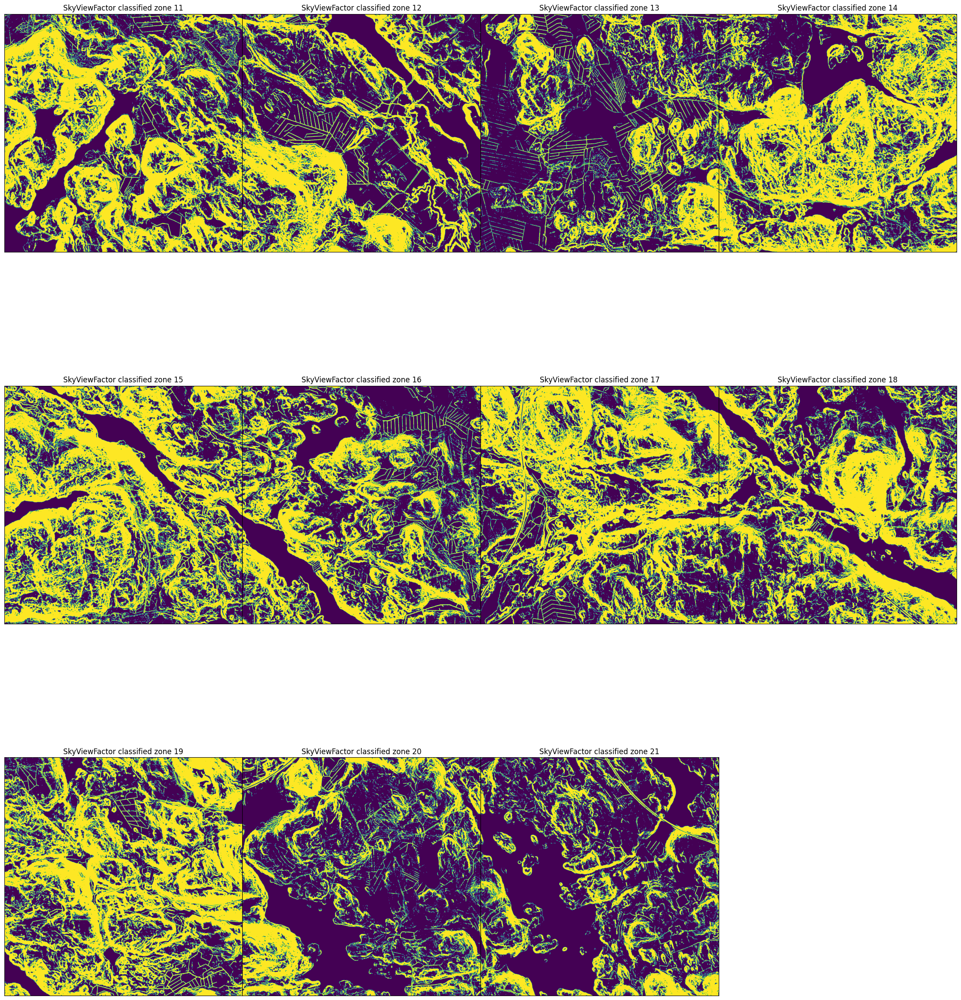

In [10]:
file_list = [f"../../01_Data/01_Raw/features/features/SVF_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < 0.998: #note: this value is "smaller than" in the original article. If I changethis, the Cohen's Kappa is negative. in article under 0.955, in here above 0.998.
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/svf_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"SkyViewFactor classified zone {l}")
    ax[l-11].imshow(classifier)
    l += 1    

The amount of false positives is big, but that can be seen from the image too. It was hard to find the exact number for streams and ditches.

In [7]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/svf_classified_{i}.npy" for i in range(11, 22)] 
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.5467384254545454
Recall score                0.6239917698924276
Precision score             0.020134131511249934
Cohen's kappa score         0.01075195538078777
AUPRC score                 0.32483473433820237
Confusion matrix
 [[147823166 123122452]
 [  1524481   2529901]]


## Code for downscaling hills and lifting up streams - Normalizing
We are interested only to view the lowest parts in the data. Normalization sets the bottom as 0. These results were no used with HPMF, the negative number was needed. If the code is closed, open it by clicking the line in front of the code editor line.

In [ ]:
# File list for SVF zones
file_list = [f"../../01_Data/01_Raw/features/SVF_Normalized_zone_{i}.npy" for i in range(11, 22)]

# Parameters for hill and valley detection
HILL_THRESHOLD = 0.998  # Threshold for hilltops (higher values for higher areas), firts treshold was 0.995
VALLEY_THRESHOLD = 0.002  # Threshold for low points (valleys, low areas), first threshold was 0.005
SMOOTHING_SIGMA = 1.5  # Gaussian smoothing to reduce noise
LOCAL_FILTER_SIZE = 10  # Neighborhood size for detecting local maxima/minima, firts filter was 5

# Process each SVF zone file
zone_idx = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    
    # Step 1: Smooth the data to reduce noise
    smoothed_zone = gaussian_filter(zone, sigma=SMOOTHING_SIGMA)

    # Step 2: Detect local maxima (high points, hilltops) and minima (low points, valleys)
    local_max = maximum_filter(smoothed_zone, size=LOCAL_FILTER_SIZE)
    local_min = minimum_filter(smoothed_zone, size=LOCAL_FILTER_SIZE)
    
    # Step 3: Identify local maxima (hills) and local minima (valleys)
    high_points = (smoothed_zone == local_max) & (smoothed_zone > HILL_THRESHOLD)
    low_points = (smoothed_zone == local_min) & (smoothed_zone < VALLEY_THRESHOLD)
    
    # Debug: Visualize the smoothed data, local maxima, and local minima
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(smoothed_zone, cmap='terrain')
    plt.title(f"Smoothed Zone {zone_idx}")
    plt.colorbar()

    plt.subplot(1, 3, 2)
    plt.imshow(local_max, cmap='terrain')
    plt.title(f"Local Maxima (Hills) Zone {zone_idx}")
    plt.colorbar()

    plt.subplot(1, 3, 3)
    plt.imshow(local_min, cmap='terrain')
    plt.title(f"Local Minima (Valleys) Zone {zone_idx}")
    plt.colorbar()
    plt.show()

    # Step 4: Create a binary classifier for hills (high points) and valleys (low points)
    classifier = np.zeros_like(zone)
    classifier[high_points] = 1  # Mark hills as 1 (binary: white)
    classifier[low_points] = -1  # Mark valleys as -1 (binary: black)

    # Save the classified data
    np.save(f"../../01_Data/02_Clean/experiment_data/svf2_classifiednorm_{zone_idx}.npy", classifier) #svf was threshold 0.995

    # Visualize the results in the subplot
    ax[zone_idx - 11].title.set_text(f"SkyViewFactor classified zone {zone_idx}")
    ax[zone_idx - 11].imshow(classifier, cmap="coolwarm")  # Display with coolwarm colormap for hills/valleys contrast

    zone_idx += 1

# Display the final plot
plt.show()

#The image was removed from here to save space

### Test with normalized data
Negative Cohen's kappa scre means the result is bad, not usable. AUPRC is also not so good. I will not use the normalized SVF images.

In [7]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/svf_classifiednorm_{i}.npy" for i in range(11, 22)] 
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9204154618181818
Recall score                0.022783990260414534
Precision score             0.00512735375371695
Cohen's kappa score         -0.016086000488511054
AUPRC score                 0.02115932109797483
Confusion matrix
 [[253021877  17923741]
 [  3962007     92375]]


# Impoundment Index classification
We load the Impoundment index for all the examined zones and reclassify it to binary. The threshold used is 0.13.

In forested areas, remeber check in QGIS wich ones from the lines are forest machines tire marks. They do look like ditches too. In the zone 13, the digitized wetland ditching comes up really well.

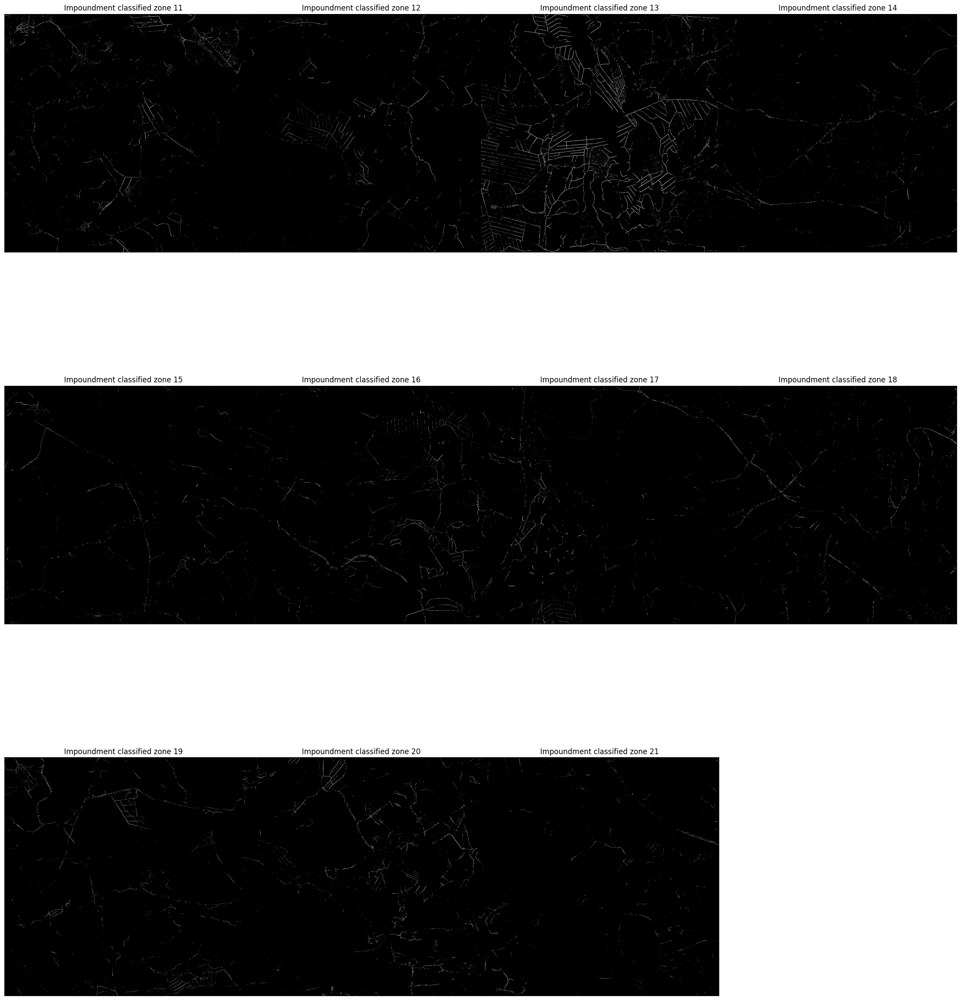

In [5]:
file_list = [f"../../01_Data/01_Raw/features/Impoundment_Normalized_zone_{i}.npy" for i in range(11, 22)] 
plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] > 0.13: # < gives backround as 1's and streams as 0's
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/imp_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"Impoundment classified zone {l}")
    ax[l-11].imshow(classifier, cmap='gray')
    l += 1

## Impoundment index size results

Label3m is all the streams and the ditches in the area. 

Because of the use of negative numbers, the normalized data, setting the lowest number into 0, does not fit in this. It was helpful in visalization while creating the DEM images from the area. In here the negative numbers are needed. 

In [ ]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/imp_classified_{i}.npy" for i in range(11, 22)] #Normalization does not work in here, because of the negative numbers. 
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9835912945454546
Recall score                0.1731755912491719
Precision score             0.37702738404899017
Cohen's kappa score         0.2301932207461359
AUPRC score                 0.2811965094672628
Confusion matrix
 [[269785486   1160132]
 [  3352262    702120]]


# HPMF classification

We load the HPMF for all the examined zones and reclassify it to binary. Change the threshold you need for your study area, in here the used threshold is -0.060. The testing started from -0.025 and was lifted up step by step. The value was checked from original tif file in QGIS end the origina l HPMF was used in here, not the normalized one. The normalization in here set the lowest level to zero, but I was using negative number in here. The file test_data.ipynb can be used for viewing the original npy data. 

In the zone 13, the digitized wetland ditching comes up really well.

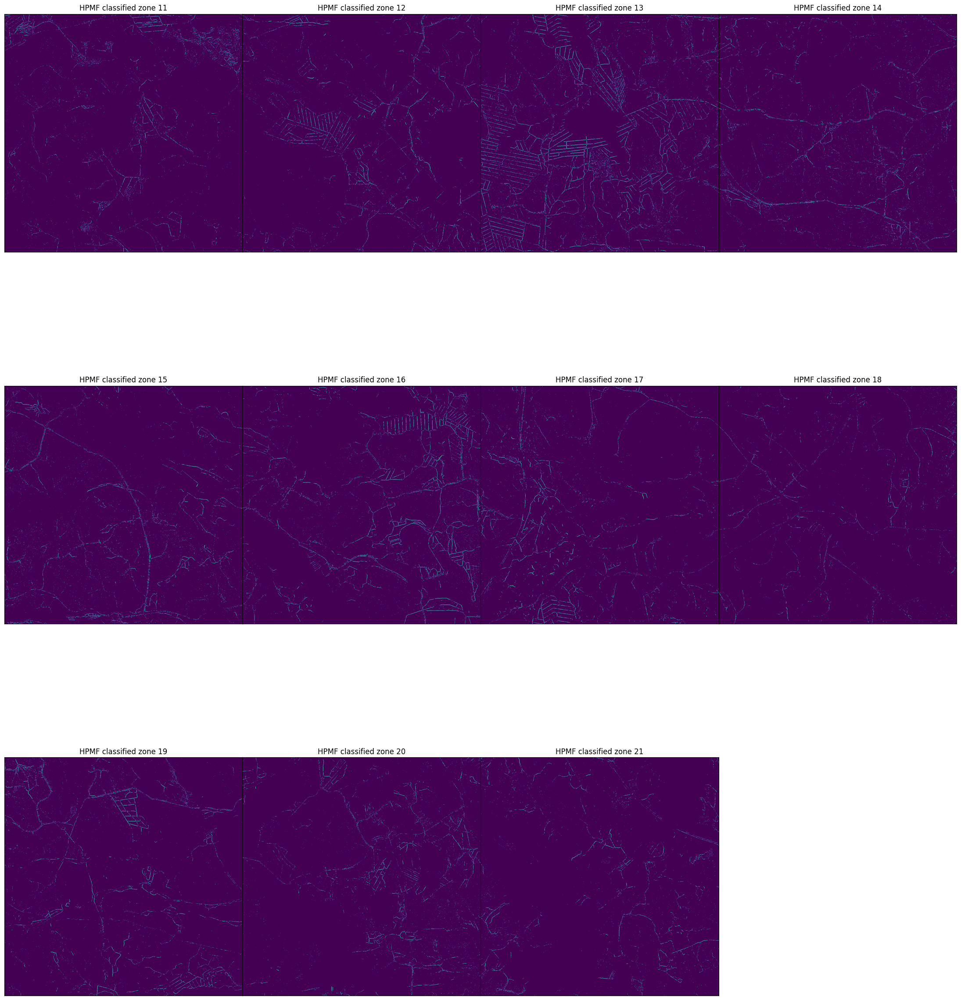

In [13]:
file_list = [f"../../01_Data/01_Raw/features/features/HPMF_{i}.npy" for i in range(11, 22)]  

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < -0.060:
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/hpmf_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"HPMF classified zone {l}")
    ax[l-11].imshow(classifier)
    l += 1

This should find more streams because the open field ditches were not mapped beforehand in National Land Syrvey of Finalnd map. 

In [14]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/hpmf_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9817593018181818
Recall score                0.19147529759159349
Precision score             0.3087425500250951
Cohen's kappa score         0.22764580236698007
AUPRC score                 0.25606904744470793
Confusion matrix
 [[269207494   1738124]
 [  3278068    776314]]


## Slope classification
Slope classification to binary data was made the same slope as in the orginal article, 14 degrees. I tested other values just because I was interest, this was the best value according to Cohen's kappa score and AUPRC score.

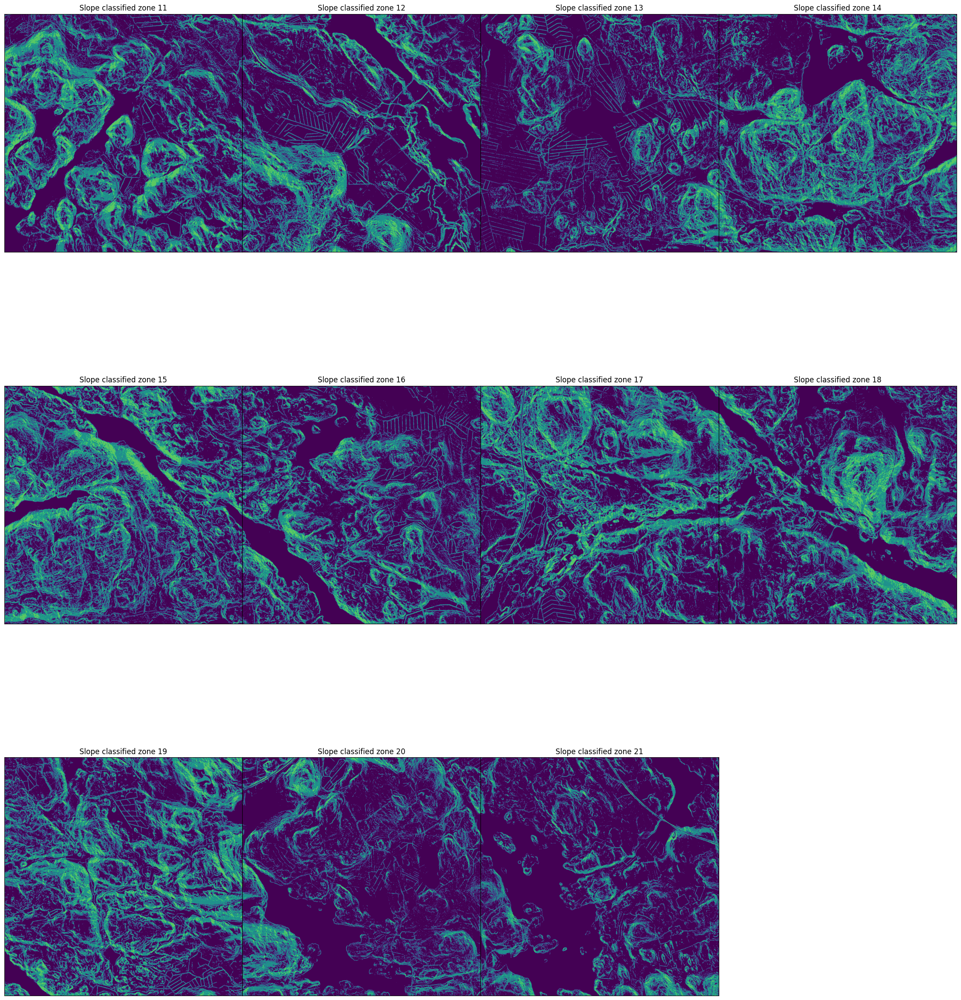

In [ ]:
file_list = [f"../../01_Data/01_Raw/features/features/slope_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] > 11: 
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/slope_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"Slope classified zone {l}")
    ax[l-11].imshow(classifier)
    l += 1


In [28]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/slope_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.8050675854545455
Recall score                0.2267142069987485
Precision score             0.017886335355526684
Cohen's kappa score         0.005990291773808942
AUPRC score                 0.12800062754077396
Confusion matrix
 [[220474400  50471218]
 [  3135196    919186]]


# Sky View Factor gabor tests
These gabor images are based on the _gabor_filter_for_SVF.ipynb code. The code creates different sets, from where I choose to use the gabor sets 1, 3, 7, 11 and 15. I searched the basic thresholds with the help of QGIS preview.
<li>gabor1 set, 1.st test treshold 236
<li>gabor3 set, 1.st test treshold 124
<li>gabor7 set, 1.st test treshold 116
<li>gabor11 set, 1.st test treshold 127
<li>gabor15 set, 1.st test treshold 116

### SVFg1 as Sky View Factor gabor1 set

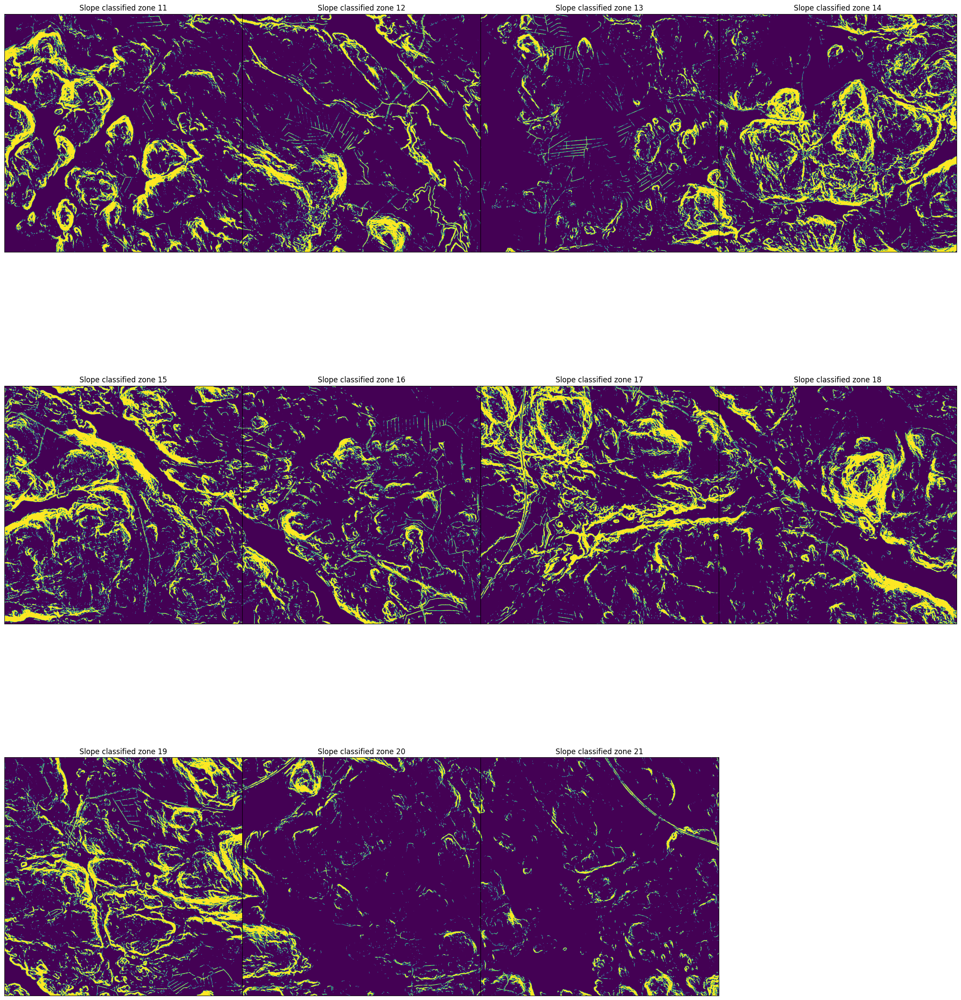

In [45]:
file_list = [f"../../01_Data/01_Raw/features/features/SVFg1_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < 236: 
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/SVFg1_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"SVFg1 classified zone {l}") #If the name from here is wrong in the plots below, it's because I forgot to change it after copy-pasting the code
    ax[l-11].imshow(classifier)
    l += 1


In [55]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/SVFg1_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.83629008
Recall score                0.1926670945165009
Precision score             0.018367745138524523
Cohen's kappa score         0.0068012304124546175
AUPRC score                 0.11146875800933088
Confusion matrix
 [[229198626  41746992]
 [  3273236    781146]]


### SVFg3 as Sky View Factor gabor3 set

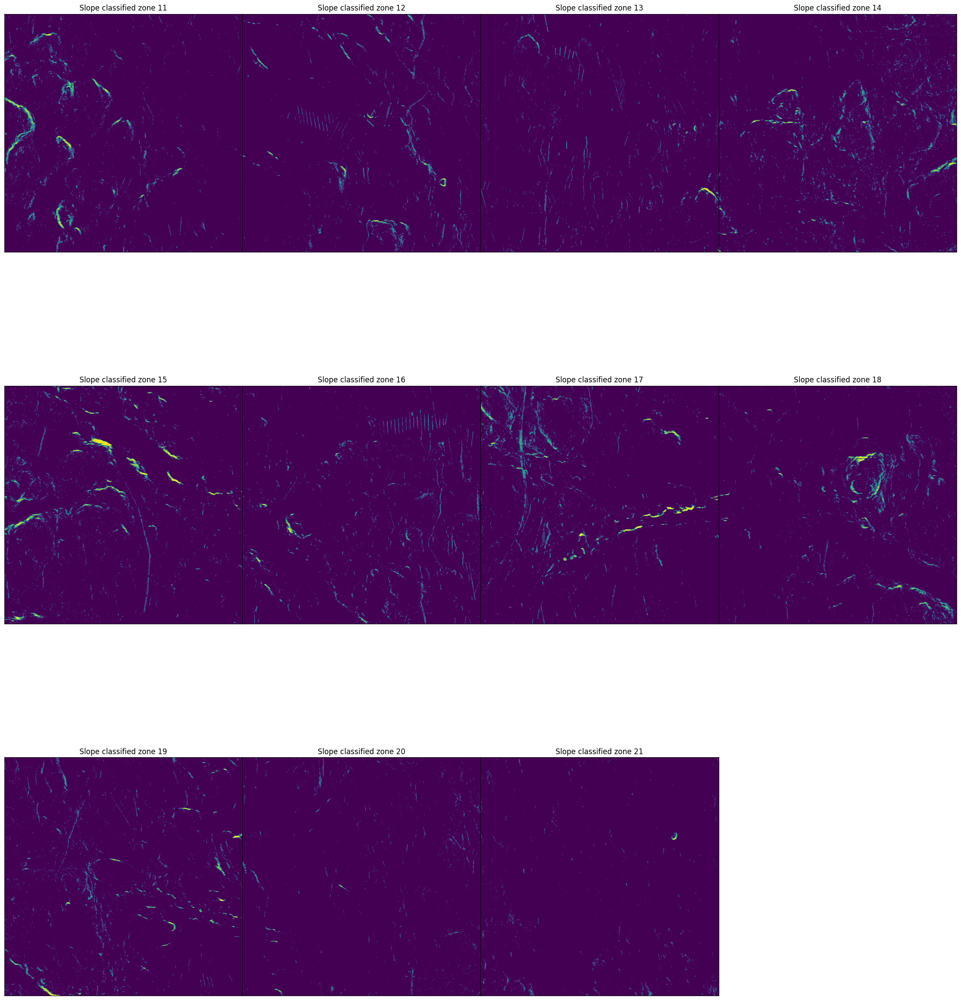

In [32]:
file_list = [f"../../01_Data/01_Raw/features/features/SVFg3_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < 124: 
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/SVFg3_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"SVFG3 classified zone {l}") #title changed in here later, wrong in plot
    ax[l-11].imshow(classifier)
    l += 1


In [56]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/SVFg3_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9748681272727273
Recall score                0.031790048397018336
Precision score             0.04138138949953141
Cohen's kappa score         0.023446807860791785
AUPRC score                 0.04372297894827487
Confusion matrix
 [[267959846   2985772]
 [  3925493    128889]]


### SVFg7 as Sky View Factor gabor7 set

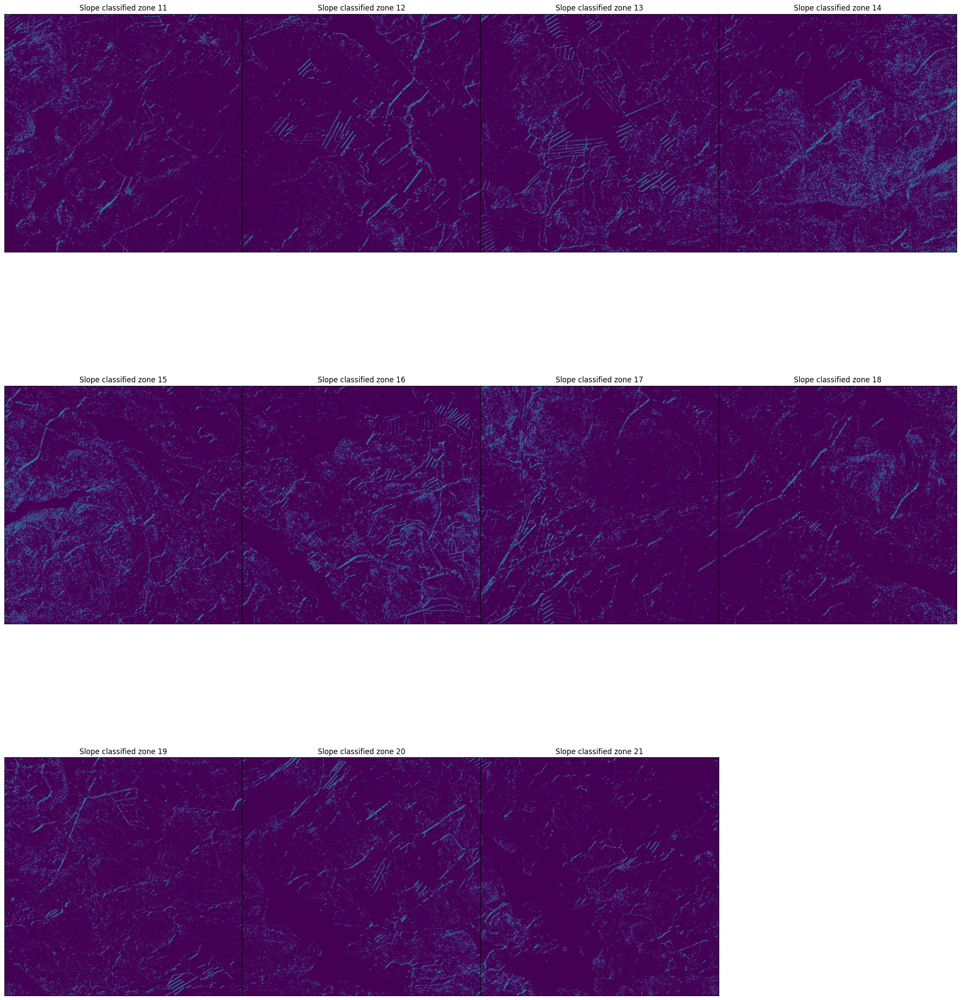

In [47]:
file_list = [f"../../01_Data/01_Raw/features/features/SVFg7_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] > 116: 
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/SVFg7_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"SVFG7 classified zone {l}") #title changed in here later, wrong in plot
    ax[l-11].imshow(classifier)
    l += 1

In [57]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/SVFg7_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9624028363636363
Recall score                0.1182962039590744
Precision score             0.06620832421093434
Cohen's kappa score         0.06726603846086165
AUPRC score                 0.09875183499409527
Confusion matrix
 [[264181162   6764456]
 [  3574764    479618]]


### SVFg11 as Sky View Factor gabor11 set

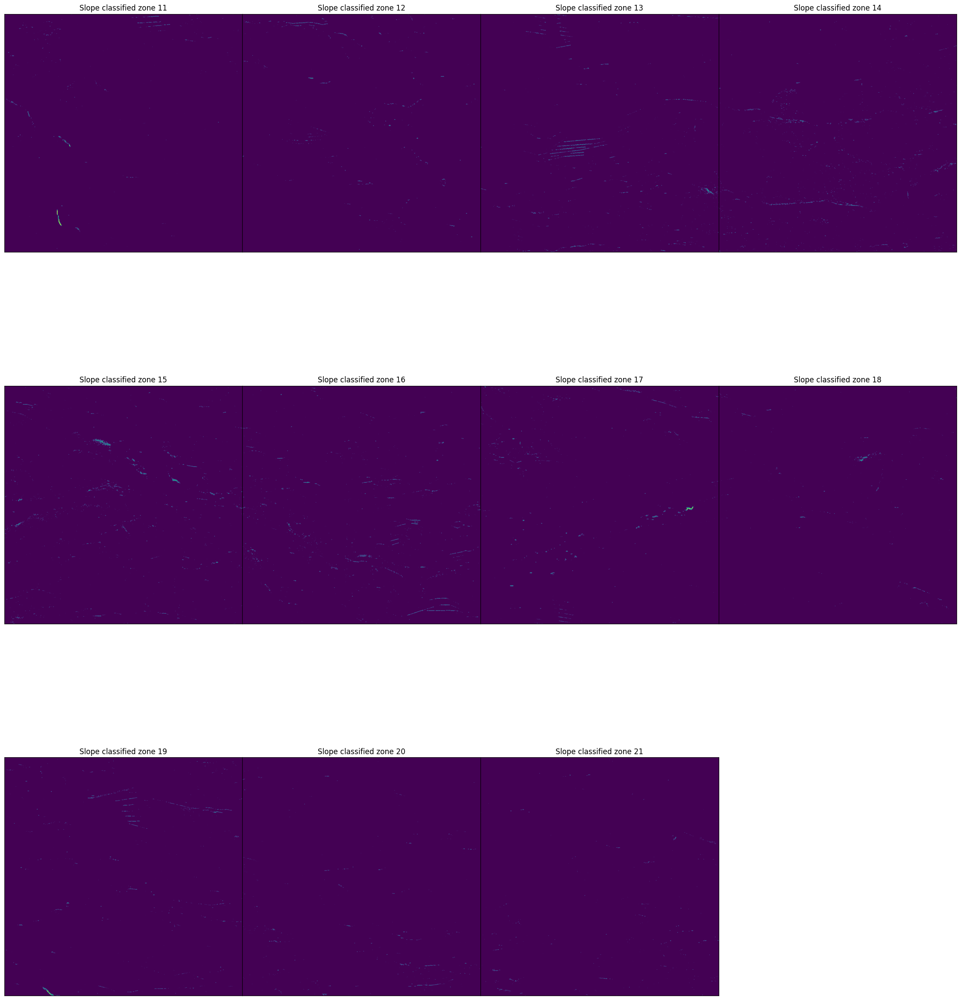

In [64]:
file_list = [f"../../01_Data/01_Raw/features/features/SVFg11_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < 127: #127 oli edellinen arvo
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/SVFg11_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"SVFg11 classified zone {l}") #title changed in here later, wrong in plot
    ax[l-11].imshow(classifier)
    l += 1

In [65]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/SVFg11_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9846039745454546
Recall score                0.010578677588840913
Precision score             0.16166299165111853
Cohen's kappa score         0.018079676181416482
AUPRC score                 0.09341445643816154
Confusion matrix
 [[270723203    222415]
 [  4011492     42890]]


### SVFg15 as Sky View Factor gabor15 set

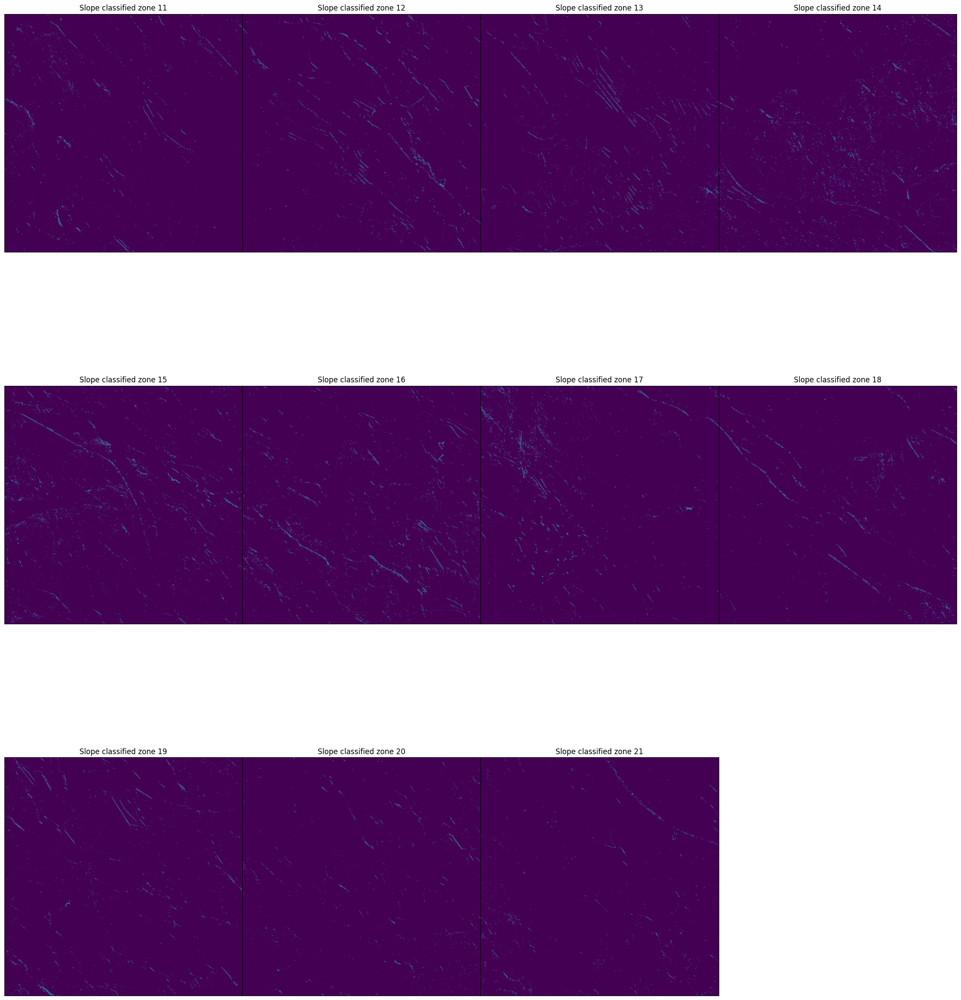

In [36]:
file_list = [f"../../01_Data/01_Raw/features/features/SVFg15_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < 116: 
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/SVFg15_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"SVFg15 classified zone {l}") #title changed in here later, wrong in plot
    ax[l-11].imshow(classifier)
    l += 1

In [59]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/SVFg15_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.98198784
Recall score                0.03132931233416091
Precision score             0.11016527262698135
Cohen's kappa score         0.04253383742401062
AUPRC score                 0.0778879488442075
Confusion matrix
 [[269919635   1025983]
 [  3927361    127021]]


### HPMF gabor

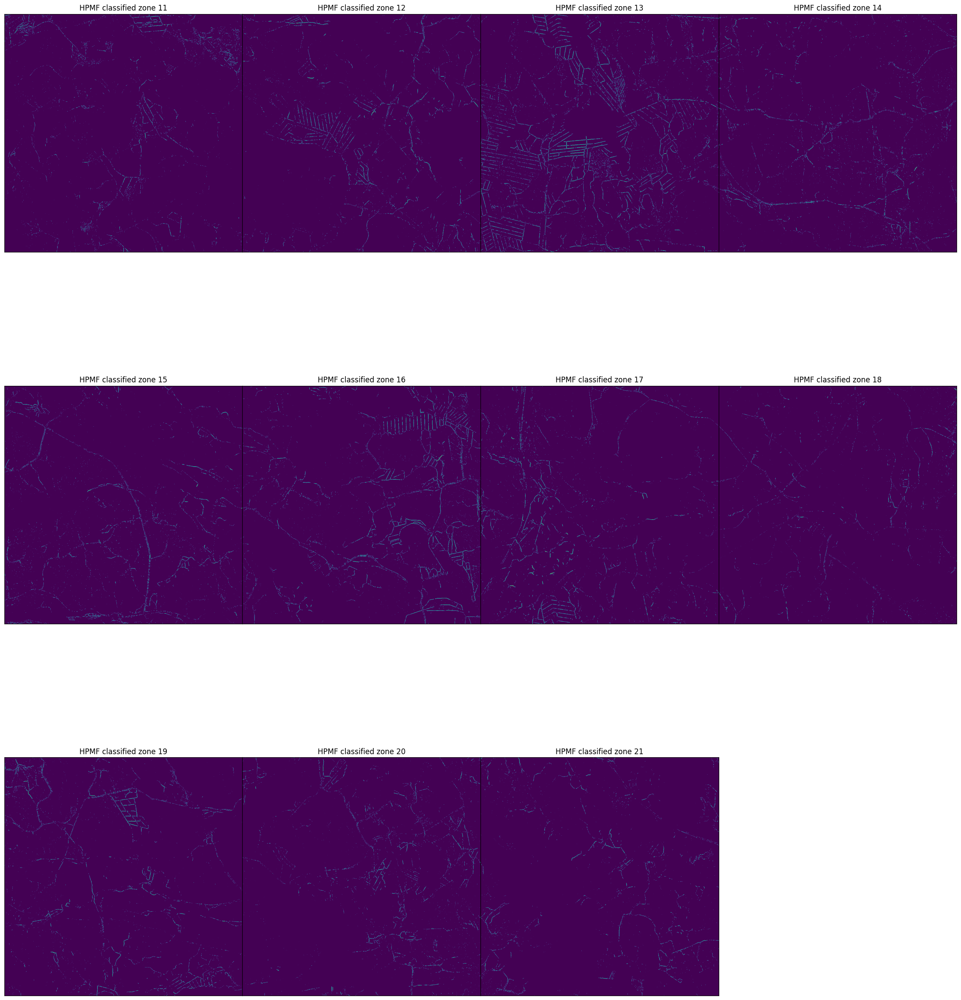

In [11]:
file_list = [f"../../01_Data/01_Raw/features/features/HPMFg_{i}.npy" for i in range(11, 22)]

plt.figure(num=None, figsize=(28,32), facecolor='w', edgecolor='k')
ax = [plt.subplot(3,4,i+1) for i in range(11)]
for a in ax:
    a.set_xticklabels([])
    a.set_yticklabels([])
    a.tick_params(bottom=False, left=False)
plt.subplots_adjust(wspace=0,hspace=0.1)

l = 11
for zone_file in file_list:
    zone = np.load(zone_file)
    classifier = zone.copy()
    
    for i in range(len(zone)):
        for j in range(len(zone[i])):
            if zone[i][j] < 73: 
                classifier[i][j] = 1
            else:
                classifier[i][j] = 0
    np.save(f"../../01_Data/02_Clean/experiment_data/hpmfg_classified_{l}.npy", classifier)
    ax[l-11].title.set_text(f"HPMF classified zone {l}")
    ax[l-11].imshow(classifier)
    l += 1

In [12]:
classifier_list = [f"../../01_Data/02_Clean/experiment_data/hpmfg_classified_{i}.npy" for i in range(11, 22)]
labels_list = [f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy" for i in range(11, 22)]

y_pred_all = []
y_test_all = []

for classifier in classifier_list:
    y_pred_all.extend(np.load(classifier).reshape(-1))
for label in labels_list:
    y_test_all.extend(np.load(label).reshape(-1))

print("Accuracy score             ", accuracy_score(y_test_all, y_pred_all))
print("Recall score               ", recall_score(y_test_all, y_pred_all))
print("Precision score            ", precision_score(y_test_all, y_pred_all))
precision, recall, threshholds = precision_recall_curve(y_test_all,y_pred_all)
auc_score = auc(recall, precision)
print("Cohen's kappa score        ", cohen_kappa_score(y_test_all, y_pred_all))
print("AUPRC score                ", auc_score)
print("Confusion matrix\n", confusion_matrix(y_test_all, y_pred_all))

Accuracy score              0.9829099963636364
Recall score                0.16870931254134416
Precision score             0.3397309914159829
Cohen's kappa score         0.21780418717799732
AUPRC score                 0.26034809743320897
Confusion matrix
 [[269616237   1329381]
 [  3370370    684012]]
